# **CONNECTION AND CONFIGURATION**

In [1]:
# Check if NVIDIA GPU is enabled
!nvidia-smi

Tue Feb  7 09:58:16 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 510.47.03    Driver Version: 510.47.03    CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   70C    P0    25W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [2]:
import torch
import os
from IPython.display import Image, clear_output  # to display images
import glob
import  shutil

from sklearn.model_selection import train_test_split

In [4]:
#Conecting with google drive
from google.colab import drive
drive.mount('/content/gdrive')
!ln -s /content/gdrive/My\ Drive/ /mydrive

Mounted at /content/gdrive


## Install Requirements

In [5]:
#clone YOLOv5
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
!pip install -qr requirements.txt # install dependencies

Cloning into 'yolov5'...
remote: Enumerating objects: 15070, done.
remote: Counting objects: 100% (51/51), done.
remote: Compressing objects: 100% (39/39), done.
remote: Total 15070 (delta 25), reused 29 (delta 12), pack-reused 15019
Receiving objects: 100% (15070/15070), 14.07 MiB | 23.05 MiB/s, done.
Resolving deltas: 100% (10324/10324), done.
/content/yolov5
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.0/184.0 KB 8.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 KB 7.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 51.6 MB/s eta 0:00:00


#**DATASET**

The images and label are save into drive, we'll automatically create the necesary directories and copy into the right folder.



```
Dataset directory format

content/yolov5/data____train___images
                  |      |_____labels
                  |
                  |____val_____images
                  |      |_____labels
                  |
                  |____test___images
                         |_____labels


```


In [11]:
image_path = '/content/gdrive/MyDrive/yolov5'

In [12]:
!mkdir data/obj
!unzip {image_path}/dataset.zip -d data/obj  

mkdir: cannot create directory ‘data/obj’: File exists
Archive:  /content/gdrive/MyDrive/yolov5/dataset.zip
  inflating: data/obj/dataset/m13-m14-0000.jpg  
  inflating: data/obj/dataset/m13-m14-0000.txt  
  inflating: data/obj/dataset/m13-m14-0022.jpg  
  inflating: data/obj/dataset/m13-m14-0022.txt  
  inflating: data/obj/dataset/m13-m14-0025.jpg  
  inflating: data/obj/dataset/m13-m14-0025.txt  
  inflating: data/obj/dataset/m13-m14-0028.jpg  
  inflating: data/obj/dataset/m13-m14-0028.txt  
  inflating: data/obj/dataset/m13-m14-0031.jpg  
  inflating: data/obj/dataset/m13-m14-0031.txt  
  inflating: data/obj/dataset/m13-m14-0034.jpg  
  inflating: data/obj/dataset/m13-m14-0034.txt  
  inflating: data/obj/dataset/m13-m14-0037.jpg  
  inflating: data/obj/dataset/m13-m14-0037.txt  
  inflating: data/obj/dataset/m13-m14-0040.jpg  
  inflating: data/obj/dataset/m13-m14-0040.txt  
  inflating: data/obj/dataset/m13-m14-0043.jpg  
  inflating: data/obj/dataset/m13-m14-0043.txt  
  inflatin

In [13]:
image_path = os.getcwd()

##Split into train, tests and validation

In [14]:
images_list = glob.glob(f"{image_path}/data/obj/dataset/*.jpg")
label_list = glob.glob(f"{image_path}/data/obj/dataset/*.txt")


In [15]:
images_list.sort()
label_list.sort()

# Split the dataset into train-valid-test splits 
train_images, val_images, train_annotations, val_annotations = train_test_split(images_list, label_list, test_size = 0.2, random_state = 1)
val_images, test_images, val_annotations, test_annotations = train_test_split(val_images, val_annotations, test_size = 0.5, random_state = 1)

In [16]:
%cd {image_path}/data

!mkdir train   test   val
!mkdir train/images  train/labels   test/images  test/labels  val/images  val/labels


/content/yolov5/data


In [17]:
#Utility function to move images 
def move_files_to_folder(list_of_files, destination_folder):
    for f in list_of_files:
        try:
            shutil.move(f, destination_folder)
        except:
            print(f)
            assert False

# Move the splits into their folders

move_files_to_folder(train_images, './train/images/')
move_files_to_folder(val_images, './val/images/')
move_files_to_folder(test_images, './test/images/')
move_files_to_folder(train_annotations, './train/labels/')
move_files_to_folder(val_annotations, './val/labels/')
move_files_to_folder(test_annotations, './test/labels/')

%cd ../

/content/yolov5


In [18]:
print("Number of training images:", len(os.listdir(f'{image_path}/data/train/images')))
print("Number of test images:", len(os.listdir(f'{image_path}/data/test/images')))
print("Number of validation images:", len(os.listdir(f'{image_path}/data/val/images')))

Number of training images: 254
Number of test images: 32
Number of validation images: 32


###*Create .yalm file*

Create file obj.names in the directory .\yolov5\data\, containing (where classes = number of objects): 

* train  = data/train
* test = data/test
* valid  = data/val
* classes = 1
* names = ['object']


In [19]:
!echo -e 'train : /content/yolov5/data/train\ntest: /content/yolov5/data/test\nval: /content/yolov5/data/val\n#Classes\nnc: 1\nnames: ["maiz14"]'> data/custom.yaml

#**PRETRAINED WEIGHTS**

For this Yolo version we`ll use a generic Coco pretained checkpoint. It's download in the train sentence.

#**TRAIN**

<font color='RED'>*RUN THE METRIC CELL BEFORE STARTING THE TRAINIG TO FOLLOW TRAINING*</font>


Here, we are able to pass a number of arguments:
- **img:** define input image size
- **batch:** determine batch size
- **epochs:** define the number of training epochs. (Note: often, 3000+ are common here!)
- **data:** Our dataset locaTion
- **weights:** specify a path to weights to start transfer learning from. Here we choose the generic COCO pretrained checkpoint.
- **cache:** cache images for faster training

In [21]:
!python train.py --img 416 --batch 16 --epochs 200 --data /content/yolov5/data/custom.yaml --weights yolov5s.pt --cache

train: weights=yolov5s.pt, cfg=, data=/content/yolov5/data/custom.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=200, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-80-gc3c8e71 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hs

#**METRICS**

Training losses and performance metrics are saved to Tensorboard and also to a logfile.
You must run the tensorboard before starting the training to follow the training.


In [20]:
# Start tensorboard

# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

In [22]:
# define helper functions to show images
def imShow(path):
  import cv2
  import matplotlib.pyplot as plt
  %matplotlib inline

  image = cv2.imread(path)
  height, width = image.shape[:2]
  resized_image = cv2.resize(image,(3*width, 3*height), interpolation = cv2.INTER_CUBIC)

  fig = plt.gcf()
  fig.set_size_inches(18, 10)
  plt.axis("off")
  plt.imshow(cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB))
  plt.show()

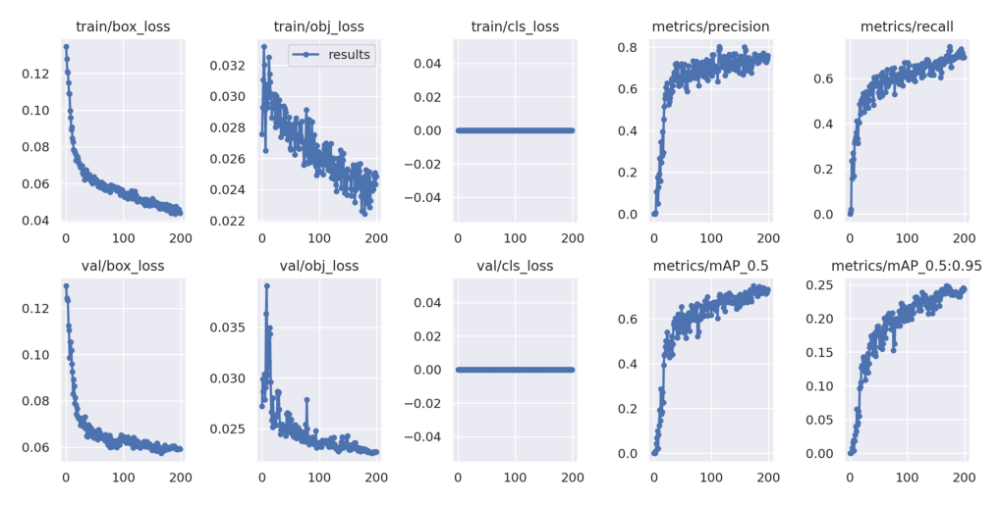

In [23]:
imShow('/content/yolov5/runs/train/exp/results.png')

#**DETECTION**
Run inference with a pretrained checkpoint on contents of `test/images` folder.

In [24]:
!python detect.py --weights runs/train/exp/weights/best.pt --img 416 --conf 0.24 --source /content/yolov5/data/test/images

detect: weights=['runs/train/exp/weights/best.pt'], source=/content/yolov5/data/test/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.24, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-80-gc3c8e71 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/32 /content/yolov5/data/test/images/m13-m14-0031.jpg: 320x416 11 maiz14s, 17.4ms
image 2/32 /content/yolov5/data/test/images/m13-m14-0055.jpg: 320x416 12 maiz14s, 9.2ms
image 3/32 /content/yolov5/data/test/images/m13-m14-0073.jpg: 320x416 12 maiz14s, 9.1ms
image 4/32 /content/yolov5/data/test/images/m13-m14-0106.jpg: 320x416

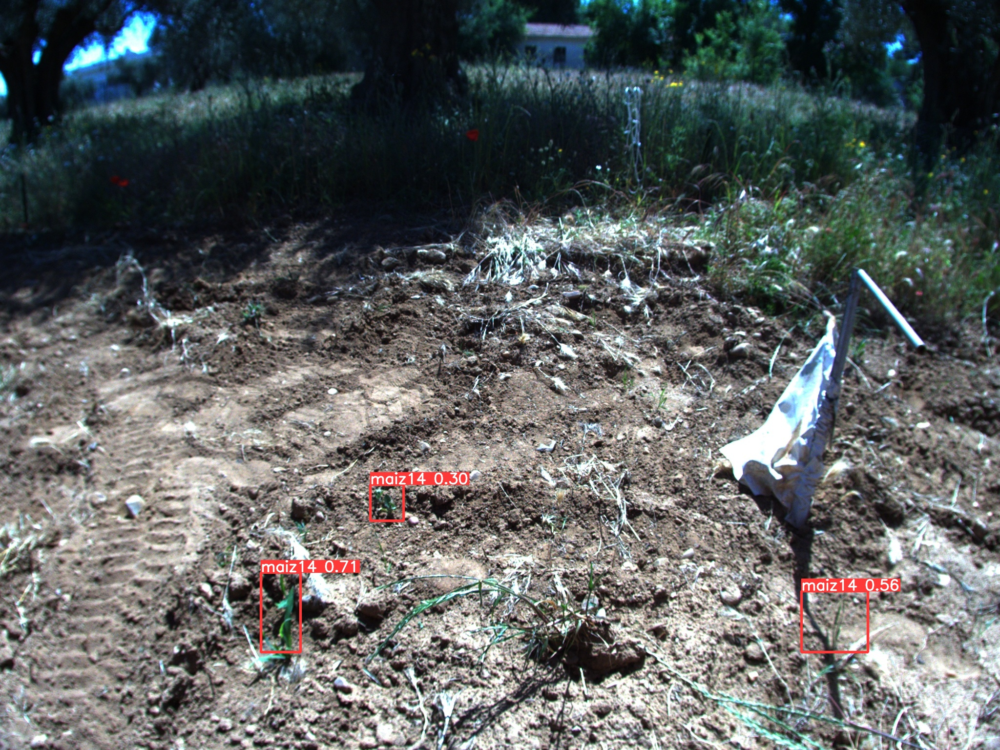

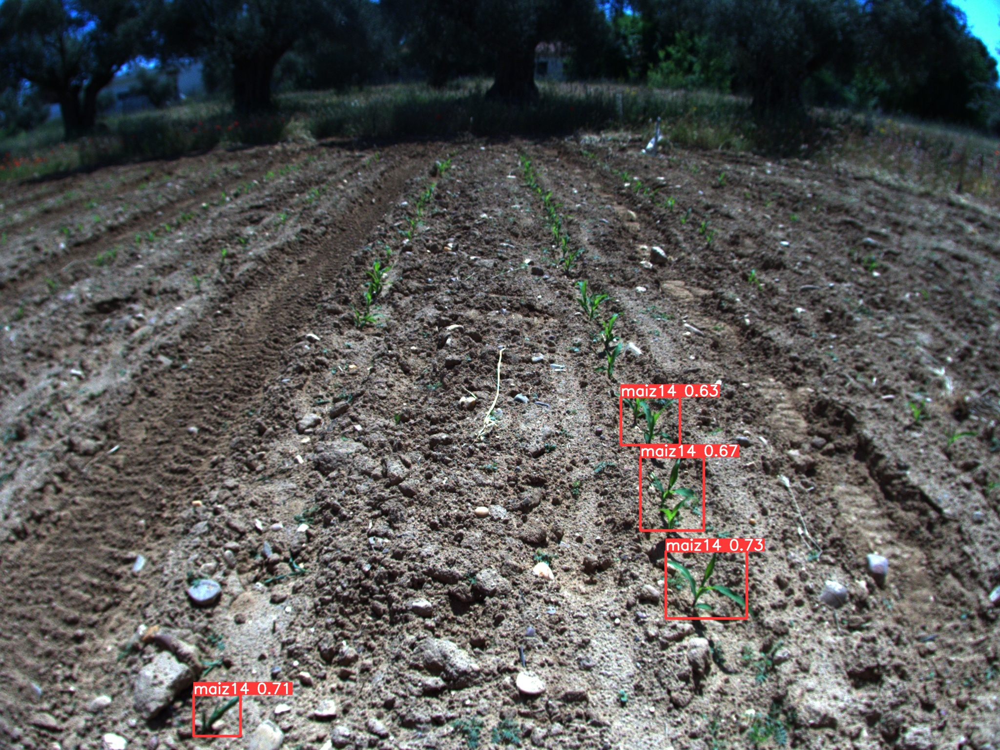

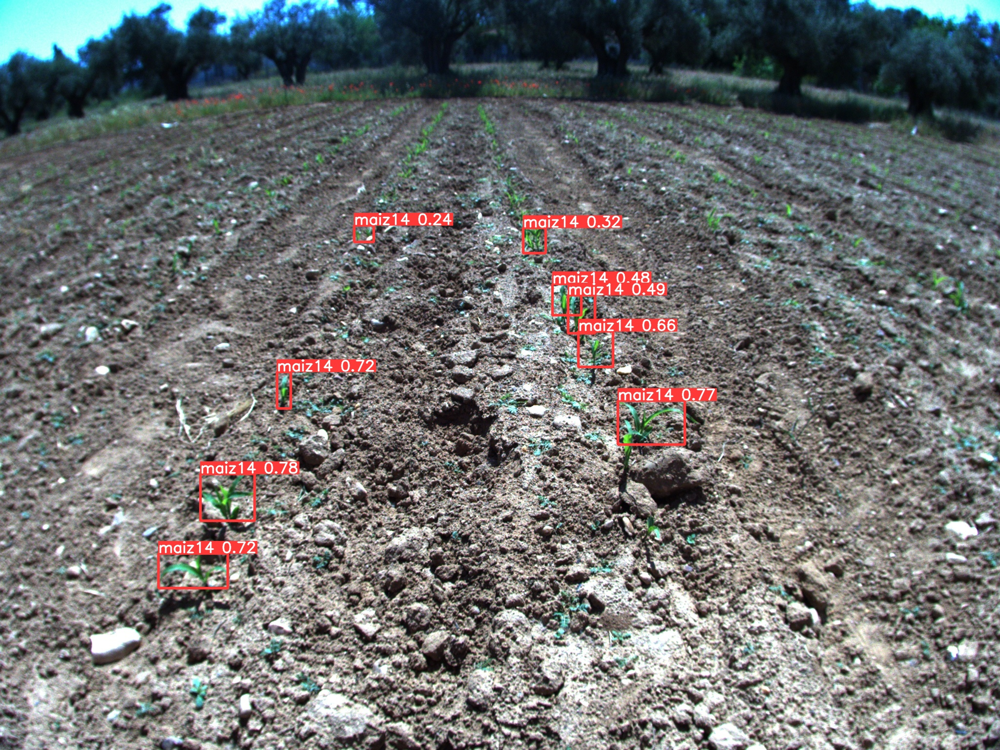

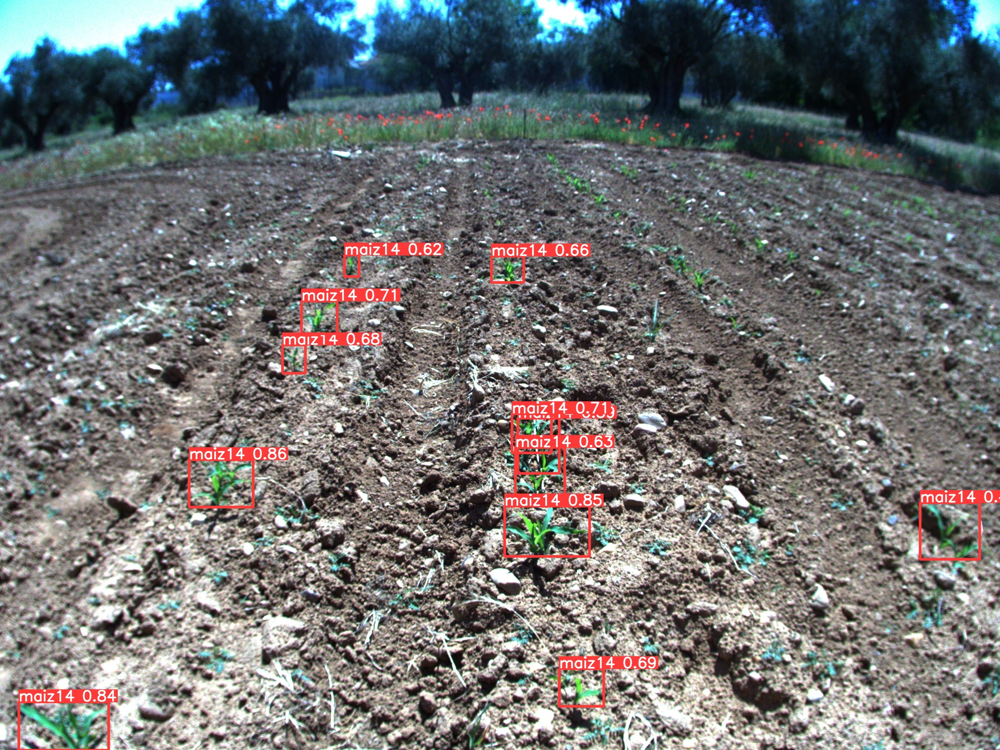

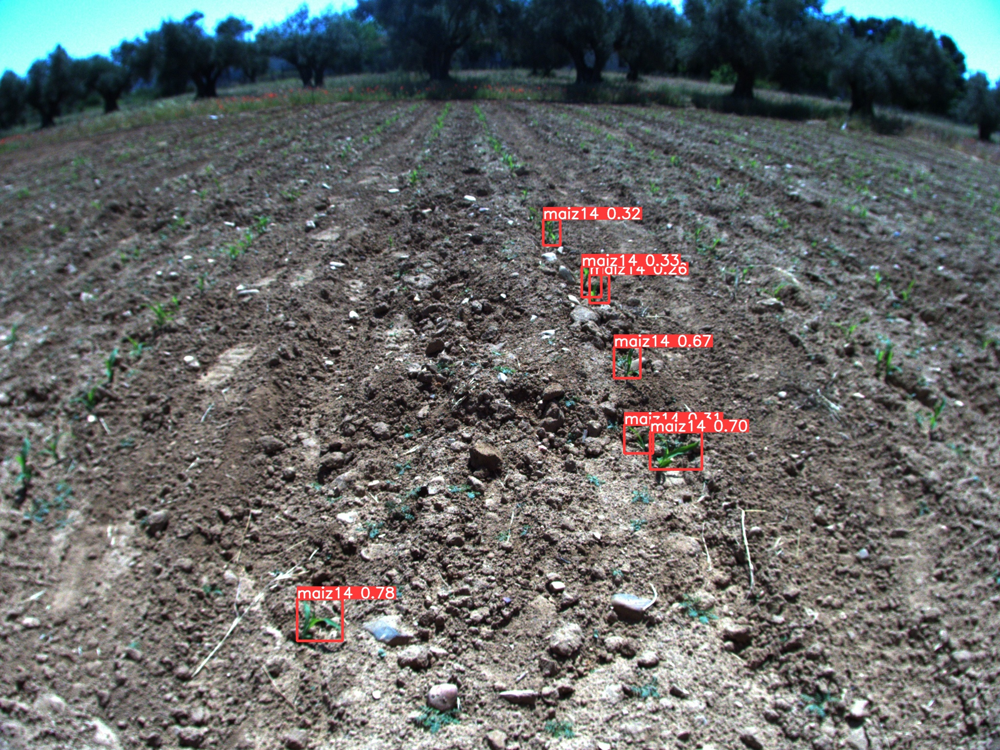

In [25]:
#display inference on some test images

import glob
from IPython.display import Image, display

i = 7  #inicial image to print
limit = i + 5 # max images to print
for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    if i < limit:
      display(Image(filename=imageName))
      print("\n\n")
    i = i + 1

We'll run the detection into one specific image

In [26]:
!python detect.py --weights runs/train/exp/weights/best.pt --img 416 --conf 0.24 --source /content/gdrive/MyDrive/yolov5/m13-m14-1410.jpg

detect: weights=['runs/train/exp/weights/best.pt'], source=/content/gdrive/MyDrive/yolov5/m13-m14-1410.jpg, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.24, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-80-gc3c8e71 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/1 /content/gdrive/MyDrive/yolov5/m13-m14-1410.jpg: 320x416 11 maiz14s, 15.9ms
Speed: 0.5ms pre-process, 15.9ms inference, 1.6ms NMS per image at shape (1, 3, 416, 416)
Results saved to runs/detect/exp2


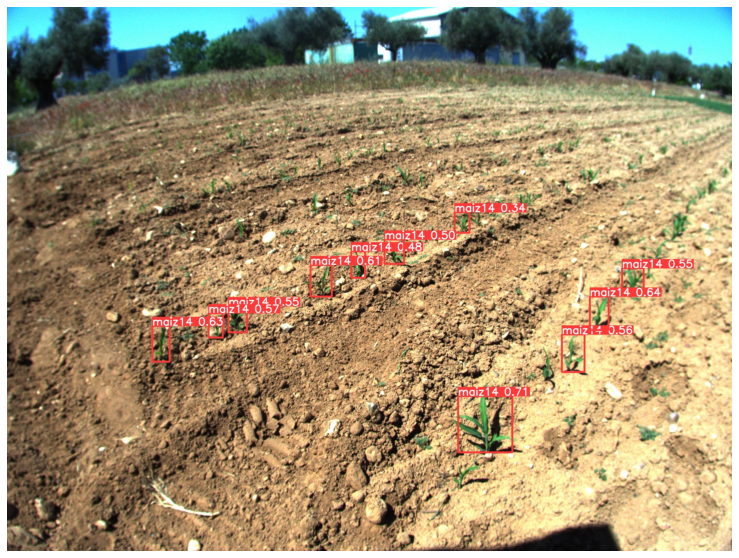

In [27]:
imShow('runs/detect/exp2/m13-m14-1410.jpg')

Save into Drive, metrics, weight and results

In [28]:
#copy the results into Drive for future use
!cp -av /content/yolov5/runs /content/gdrive/MyDrive/yolov5/runs

'/content/yolov5/runs' -> '/content/gdrive/MyDrive/yolov5/runs'
'/content/yolov5/runs/train' -> '/content/gdrive/MyDrive/yolov5/runs/train'
'/content/yolov5/runs/train/exp' -> '/content/gdrive/MyDrive/yolov5/runs/train/exp'
'/content/yolov5/runs/train/exp/weights' -> '/content/gdrive/MyDrive/yolov5/runs/train/exp/weights'
'/content/yolov5/runs/train/exp/weights/last.pt' -> '/content/gdrive/MyDrive/yolov5/runs/train/exp/weights/last.pt'
'/content/yolov5/runs/train/exp/weights/best.pt' -> '/content/gdrive/MyDrive/yolov5/runs/train/exp/weights/best.pt'
'/content/yolov5/runs/train/exp/hyp.yaml' -> '/content/gdrive/MyDrive/yolov5/runs/train/exp/hyp.yaml'
'/content/yolov5/runs/train/exp/opt.yaml' -> '/content/gdrive/MyDrive/yolov5/runs/train/exp/opt.yaml'
'/content/yolov5/runs/train/exp/events.out.tfevents.1675764543.4e4ae391baed.3115.0' -> '/content/gdrive/MyDrive/yolov5/runs/train/exp/events.out.tfevents.1675764543.4e4ae391baed.3115.0'
'/content/yolov5/runs/train/exp/labels_correlogram.jpg